In [117]:
import os, sys
os.environ['PYTHONHASHSEED']=str(0)
import random
random.seed(0)
import numpy as np
np.random.seed(0)
import tensorflow as tf
tf.set_random_seed(0)

import pandas as pd
import matplotlib.pyplot as plt
import pickle
import itertools
import time
import itertools
from IPython.display import display, clear_output
import glob
import tqdm
import h5py

from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import SimpleRNN
from keras.initializers import glorot_uniform
from keras import optimizers

from keras.optimizers import Adam
from keras.models import load_model
from keras.callbacks import ModelCheckpoint
from keras.callbacks import Callback

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

from keras.datasets import mnist
from keras.layers import Input, Dense
from keras.models import Model
from keras.callbacks import TensorBoard
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D
from keras.models import Model
from keras import backend as K
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import ImageDataGenerator

%config InlineBackend.figure_format = 'retina'
%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [118]:
root_path = '../'

In [146]:
xray_path = f'{root_path}data/train/*'
mask_path = f'{root_path}data/masks/*'
xray_files = sorted(glob.glob(xray_path))[:-19]
mask_files = sorted(glob.glob(mask_path))[:-19]


random.seed(2)
c = list(zip(xray_files, mask_files))
random.shuffle(c)
xray_files, mask_files = zip(*c)

batch_size = 32

train_len = 250 * batch_size
dev_len = 40 * batch_size
test_len = 40 * batch_size

X_train_files = xray_files[:train_len]
y_train_files = mask_files[:train_len]

X_dev_files = xray_files[train_len:train_len+dev_len]
y_dev_files = mask_files[train_len:train_len+dev_len]

X_test_files = xray_files[train_len+dev_len:train_len+dev_len+test_len]
y_test_files = mask_files[train_len+dev_len:train_len+dev_len+test_len]

print(f'Train:{len(X_train_files)}, dev:{len(X_dev_files)}, test:{len(X_test_files)}')

Train:8000, dev:1280, test:1280


In [120]:
# with_mask = []
# for i, f in enumerate(y_train_files):
#     m = np.sum(img_to_array(load_img(f, color_mode='grayscale')))
#     with_mask.append(m>1)
# train_positive = np.mean(with_mask)

# with_mask = []
# for i, f in enumerate(y_dev_files):
#     m = np.sum(img_to_array(load_img(f, color_mode='grayscale')))
#     with_mask.append(m>1)
# dev_positive = np.mean(with_mask)

# with_mask = []
# for i, f in enumerate(y_test_files):
#     m = np.sum(img_to_array(load_img(f, color_mode='grayscale')))
#     with_mask.append(m>1)
# test_positive = np.mean(with_mask)

# print('Images with mask:')
# print(f'Train:{train_positive}, dev:{dev_positive}, test:{test_positive}')

In [121]:
# import h5py
# data_filename = f'{root_path}data/data.h5'
# with h5py.File(data_filename, "w") as out:
    
#     data_type = 'uint8'
    
#     out.create_dataset("X_train",(len(X_train_files),256,256,1),dtype=data_type)
#     out.create_dataset("Y_train",(len(X_train_files),256,256,1),dtype=data_type)      
#     out.create_dataset("X_dev",(len(X_dev_files),256,256,1),dtype=data_type)
#     out.create_dataset("Y_dev",(len(X_dev_files),256,256,1),dtype=data_type)      
#     out.create_dataset("X_test",(len(X_test_files),256,256,1),dtype=data_type)
#     out.create_dataset("Y_test",(len(X_test_files),256,256,1),dtype=data_type)
    
#     for index in range(len(y_train_files)):
#         out['X_train'][index, :, :, :] = img_to_array(load_img(X_train_files[index], color_mode='grayscale')).astype(data_type)
#         out['Y_train'][index, :, :, :] = img_to_array(load_img(y_train_files[index], color_mode='grayscale')).astype(data_type)
        
#     for index in range(len(y_dev_files)):
#         out['X_dev'][index, :, :, :] = img_to_array(load_img(X_dev_files[index], color_mode='grayscale')).astype(data_type)
#         out['Y_dev'][index, :, :, :] = img_to_array(load_img(y_dev_files[index], color_mode='grayscale')).astype(data_type)
        
#     for index in range(len(y_test_files)):
#         out['X_test'][index, :, :, :] = img_to_array(load_img(X_test_files[index], color_mode='grayscale')).astype(data_type)
#         out['Y_test'][index, :, :, :] = img_to_array(load_img(y_test_files[index], color_mode='grayscale')).astype(data_type)


In [122]:
data_filename = f'{root_path}data/data.h5'
with h5py.File(data_filename, 'r') as f:
    a = f['X_train'][()]
    b = f['Y_train'][()]

In [123]:
def gen_number():
    for i in range(300):
        i = i
        print(f'Testing i={i}')
        yield i
        
index_gen = gen_number()

In [124]:

# for i in index_gen:
# #     i = next(index_gen)
#     if np.sum(b[i,:,:,0])>1:
#         fig, ax = plt.subplots(1, figsize=(6, 6))

        
#         ax.imshow(a[i,:,:,0]/500, cmap='bone')
#         ax.imshow(b[i,:,:,0], alpha=0.4)

#         ax.set_xticks([])
#         ax.set_yticks([])
#         plt.show()

In [125]:
basepath = 'C:\\Users\\aamico\\Desktop\\jupyter\\me\\code_pills\\andreaamico.github.io\\asset\\images\\xray'

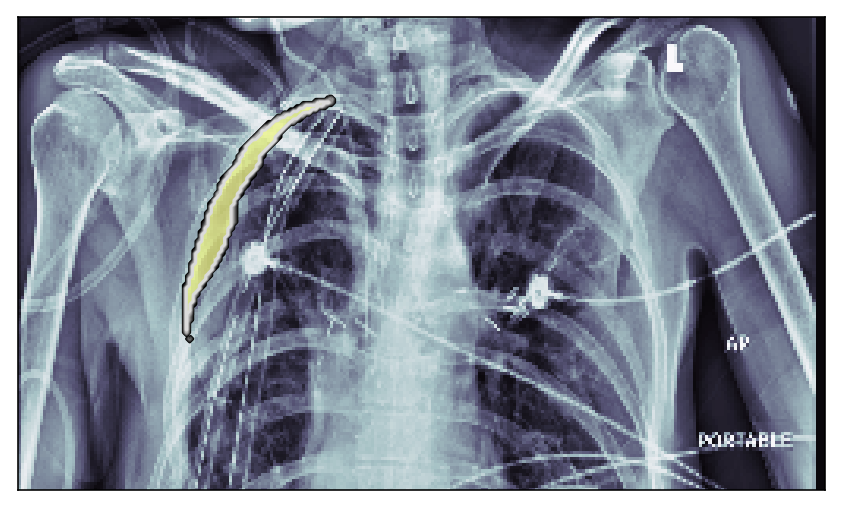

In [126]:

from matplotlib.colors import ListedColormap

cmap = plt.cm.viridis
my_cmap = cmap(np.arange(cmap.N))

# Set alpha
my_cmap[:,:] = my_cmap[:,:]**0.3
my_cmap[:,-1] = np.linspace(0, 0.8, cmap.N)

# Create new colormap
my_cmap = ListedColormap(my_cmap)

fig, ax = plt.subplots(1, figsize=(6, 4))

i=282
ax.imshow(a[i,:,:,0]/500, cmap='bone')
ax.contour(b[i,:,:,0], cmap='gray', alpha=1)
ax.contourf(b[i,:,:,0], cmap=my_cmap)


ax.set_ylim(150, 0)
# ax.set_xlim(25, 230)


ax.set_xticks([])
ax.set_yticks([])
plt.tight_layout()

# fig.savefig('../plots/intro.png',  bbox_inches='tight', pad_inches=0)
# fig.savefig(f'{basepath}/intro.png',  bbox_inches='tight', pad_inches=0, dpi=180)

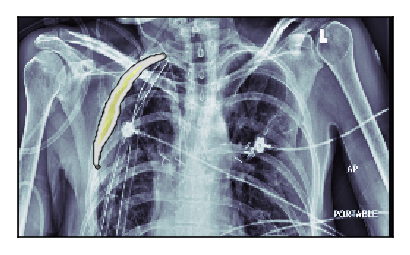

In [127]:

from matplotlib.colors import ListedColormap

cmap = plt.cm.viridis
my_cmap = cmap(np.arange(cmap.N))

# Set alpha
my_cmap[:,:] = my_cmap[:,:]**0.3
my_cmap[:,-1] = np.linspace(0, 0.8, cmap.N)

# Create new colormap
my_cmap = ListedColormap(my_cmap)

fig, ax = plt.subplots(1, figsize=(3,3))

i=282
ax.imshow(a[i,:,:,0]/500, cmap='bone')
ax.contour(b[i,:,:,0], cmap='gray', alpha=1)
ax.contourf(b[i,:,:,0], cmap=my_cmap)


ax.set_ylim(150, 0)
# ax.set_xlim(25, 230)


ax.set_xticks([])
ax.set_yticks([])
plt.tight_layout()

# fig.savefig('../plots/intro.png',  bbox_inches='tight', pad_inches=0)
fig.savefig(f'{basepath}/xray.svg',  bbox_inches='tight', pad_inches=0, dpi=550)

In [128]:
image_randomiser = ImageDataGenerator(
    rotation_range=10,
    width_shift_range=0.02,
    height_shift_range=0.02,
    zoom_range=0.02,
    fill_mode='nearest',
    horizontal_flip=True)
transformation = image_randomiser.get_random_transform(img_shape=(256,256,1))

transformed = image_randomiser.apply_transform((a[7,:,:,0]/255).reshape(256,256,1), transformation)
transformed.shape

(256, 256, 1)

In [129]:
def create_data_generator(X, y, batch_size):    
    number_of_samples = X.shape[0]
    print(f'Creating generator from {number_of_samples} samples')
    
    index = 0
    while True:
        data_X = np.zeros([batch_size, 256, 256, 1])
        data_y = np.zeros([batch_size, 256, 256, 1])
        
        for i in range(batch_size):
            data_X[i, ...] = X[index % number_of_samples,...]/255.
            data_y[i, ...] = y[index % number_of_samples,...]/255.
            index = index + 1
            
        data_X = data_X * np.ones([batch_size, 256, 256, 3])
        yield data_X, data_y
        
        
def create_data_random_generator(X, y, batch_size):
    
    image_randomiser = ImageDataGenerator(
        rotation_range=10,
        width_shift_range=0.02,
        height_shift_range=0.02,
        zoom_range=0.02,
        fill_mode='nearest',
        horizontal_flip=True)
    
    
    number_of_samples = X.shape[0]
    print(f'Creating generator from {number_of_samples} samples')
    
    index = 0
    while True:
        data_X = np.zeros([batch_size, 256, 256, 1])
        data_y = np.zeros([batch_size, 256, 256, 1])
        
        transformation = image_randomiser.get_random_transform(img_shape=(256,256,1))
        
        for i in range(batch_size):
            data_X[i, ...] = image_randomiser.apply_transform(
                        X[index % number_of_samples,...]/255., transformation)
            
            data_y[i, ...] = image_randomiser.apply_transform(
                        y[index % number_of_samples,...]/255., transformation)
            index = index + 1
            
        data_X = data_X * np.ones([batch_size, 256, 256, 3])
        yield data_X, data_y

In [ ]:
with h5py.File(data_filename, 'r') as f:
    train_generator = create_data_random_generator(f['X_train'][()], f['Y_train'][()], 32)
    
with h5py.File(data_filename, 'r') as f:
    dev_generator = create_data_generator(f['X_dev'][()], f['Y_dev'][()], 32)

In [147]:
with h5py.File(data_filename, 'r') as f:
    d = create_data_generator(f['X_dev'][()], f['Y_dev'][()], 32)
    t = create_data_generator(f['X_test'][()], f['Y_test'][()], 32)
    tt = create_data_generator(f['X_train'][()], f['Y_train'][()], 32)

In [158]:
mask_train = []
for i in tqdm.tqdm(range(250)):
    a, b = next(tt)
    for i in range(32):
        mask_train.append(a[i,:,:,0])
    

In [210]:
mask_test = []
for i in tqdm.tqdm(range(40)):
    a, b = next(t)
    for i in range(32):
        mask_test.append(a[i,:,:,0])
    


  0%|          | 0/40 [00:00<?, ?it/s]

Creating generator from 1280 samples



100%|██████████| 40/40 [00:04<00:00,  8.02it/s]

In [211]:
mtest = np.array(mask_test)

In [240]:
mtr = None

In [235]:
mt = None
mtest = None

In [225]:
concatenato = np.concatenate((mtest, mt), axis=0)

In [241]:
concatenato.shape

(9280, 256, 256)

In [167]:
mt = np.array(mask_train)

In [193]:
mtr = mt.reshape(8000, 65536)

In [205]:
mtr[-1,:] = mtr[5, :]
mtr[7,:] = mtr[97, :]
mtr[8,:] = mtr[94, :]
mtr[33,:] = mtr[93, :]
mtr[88,:] = mtr[96, :]
mtr[9,:] = mtr[99, :]

In [242]:
%%time
u, c = np.unique(concatenato, return_counts=True, axis=0)

Wall time: 33.4 s


In [219]:
# dup = u[c > 1]
# dup

In [243]:
np.sum(c>1)

7

In [196]:
256**2

65536

In [161]:
np.array_equal(mask_train[1], mask_train[1])

True

In [244]:
import pickle

with open("../plots/histories.pkl", 'rb') as pkl_file:
    h = pickle.load(pkl_file)


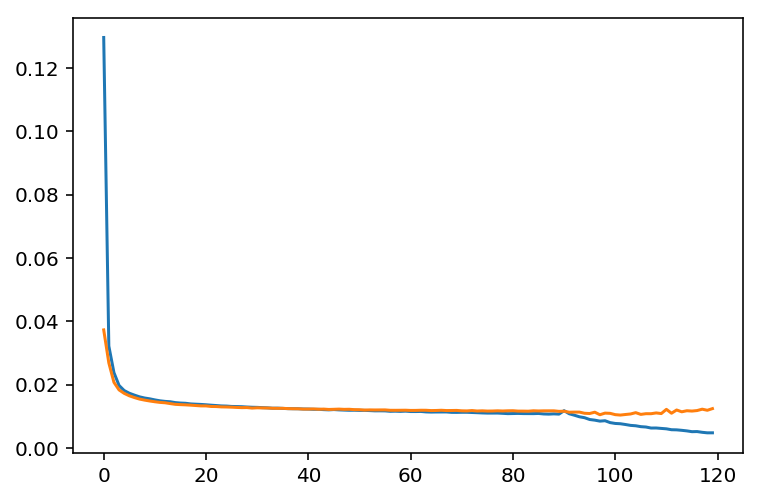

In [245]:
plt.plot(h[0])
plt.plot(h[1])

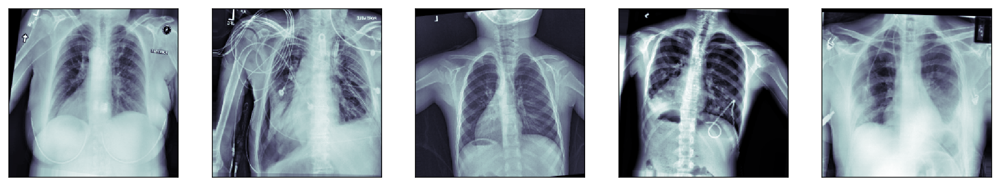

In [497]:


fig, axs = plt.subplots(1, 5, figsize=(18,4))
for ax in axs:
    a, b = next(train_generator)
    ax.imshow(a[2,:,:,0], cmap='bone')
    ax.set_xticks([])
    ax.set_yticks([])
# fig.savefig(f'{basepath}/image_data_generator.png',  bbox_inches='tight', pad_inches=0)

In [138]:
with h5py.File(data_filename, 'r') as f:
    test_generator = create_data_generator(f['X_test'][()], f['Y_test'][()], 32)

In [137]:
model_doc = load_model('../models/model_03_100epochs.h5')

In [140]:
t = []
sim = []
back = []

for i in range(3):
    a, b = next(test_generator)
    t.append(b)
    back.append(a)
    sim.append(model_doc.predict(a))
    print(i, end=' ')
print(np.mean(sim), np.mean(t))

Creating generator from 1280 samples
0 1 2 0.0028783658 0.004610661899342256


[]

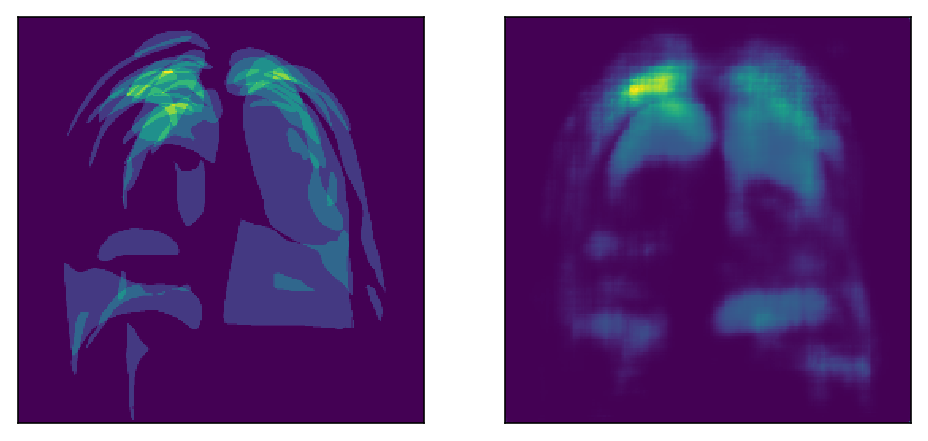

In [141]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4))
ax1.imshow(np.array(t).mean(0).mean(0).reshape(256, 256))
ax2.imshow(np.array(sim).mean(0).mean(0).reshape(256, 256))
ax1.set_xticks([])
ax1.set_yticks([])
ax2.set_xticks([])
ax2.set_yticks([])

# fig.savefig(f'{basepath}/image_data_generator.png',  bbox_inches='tight', pad_inches=0)

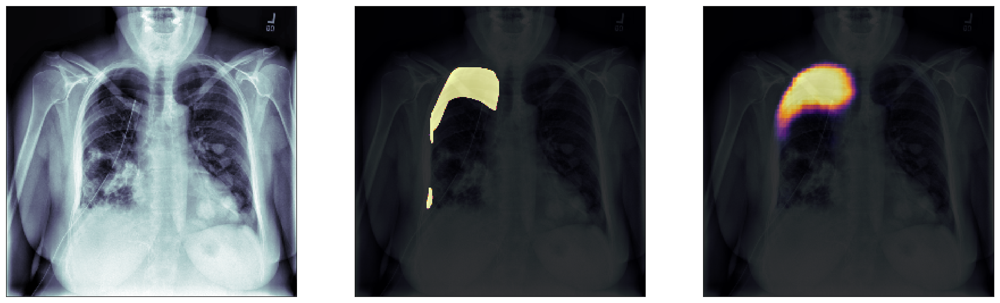

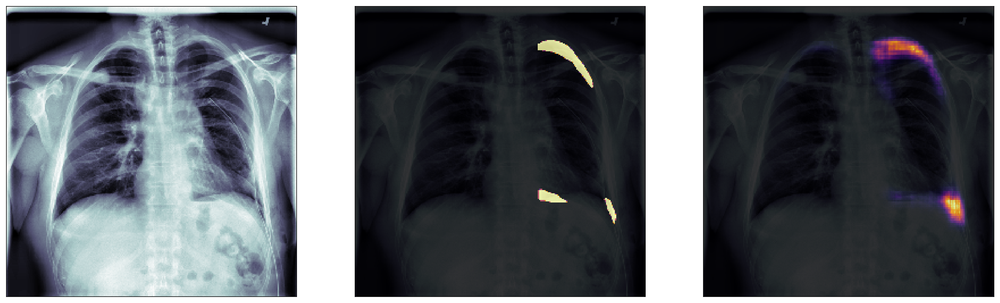

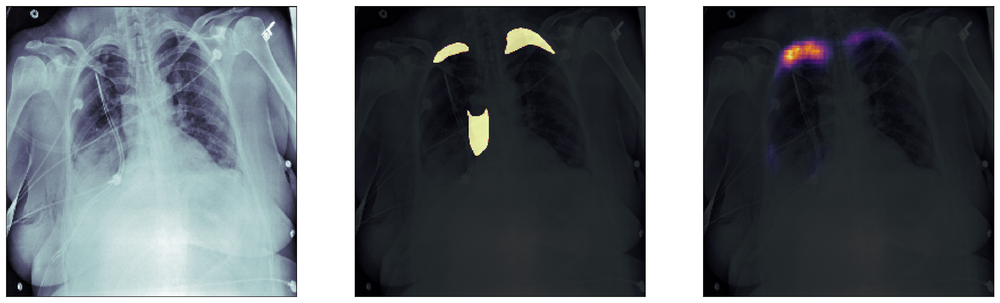

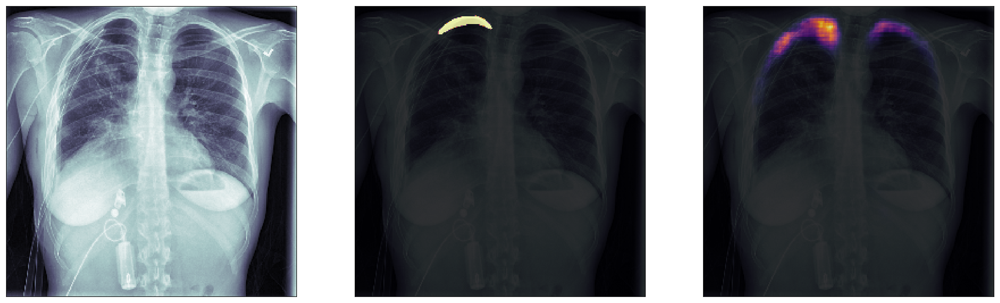

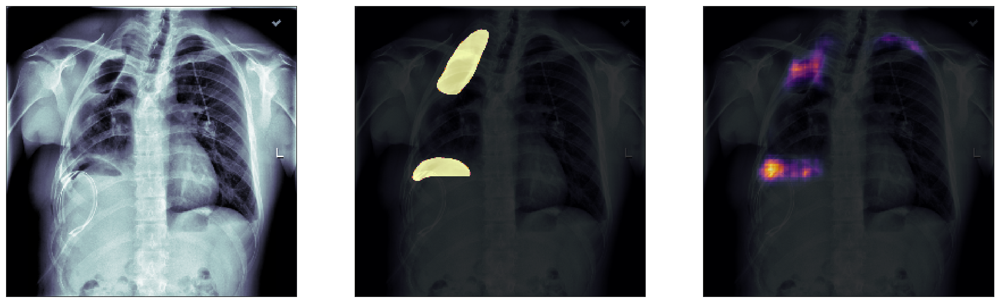

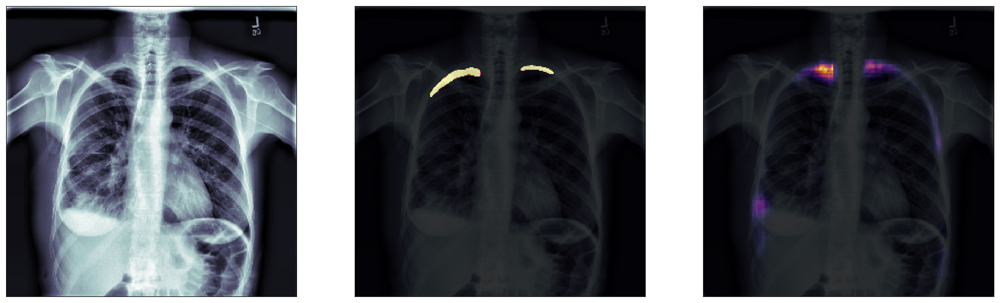

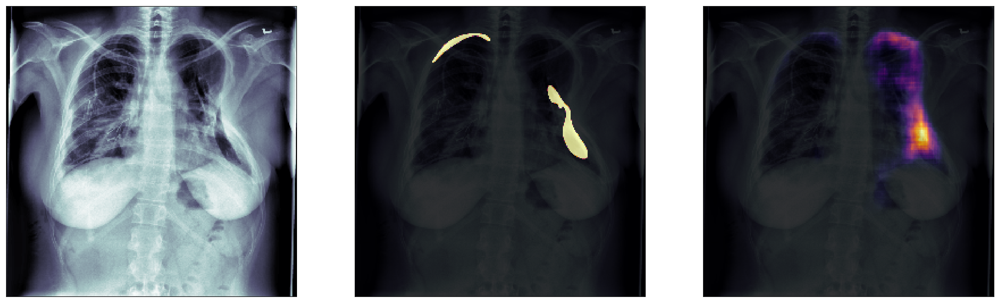

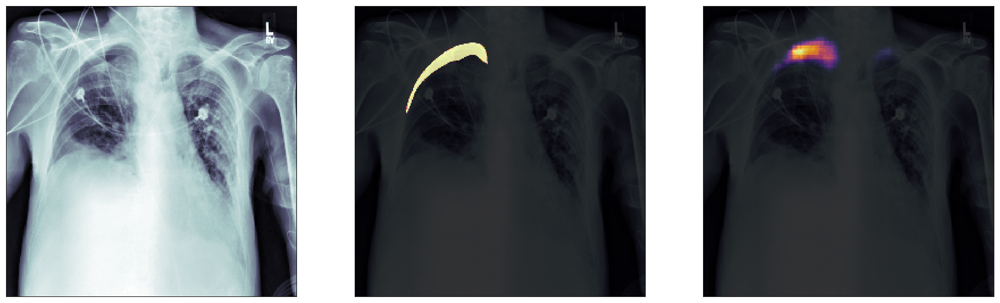

In [145]:
index = 0
for i in np.arange(0,32):
    if np.sum(t[index][i,...])>1:
        fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(25,10))
        
        ax0.imshow(back[index][i,...,0].reshape(256, 256), cmap='bone')

        
        ax1.imshow(t[index][i,...].reshape(256, 256), cmap='inferno')
        ax1.imshow(back[index][i,...,0].reshape(256, 256), cmap='bone', alpha=0.2)

        
        ax2.imshow(sim[index][i,...].reshape(256, 256), cmap='inferno')
        ax2.imshow(back[index][i,...,0].reshape(256, 256), cmap='bone', alpha=0.2)

        ax1.set_xticks([])
        ax2.set_xticks([])    
        ax1.set_yticks([])    
        ax2.set_yticks([])
        ax0.set_xticks([])    
        ax0.set_yticks([])
        
#         fig.savefig(f'{basepath}/results/test_negative_{index}_{i}.png',  bbox_inches='tight', pad_inches=0)


In [95]:
model_doc.layers[0]

In [110]:
model_doc.layers[0].layers[0].input

<tf.Tensor 'input_5:0' shape=(?, 256, 256, 3) dtype=float32>

In [111]:
from keras import models
current_model = model_doc.layers[0]


base_layer_names = [layer.name for layer in current_model.layers]
base_layer_outputs = [layer.output for layer in  current_model.layers[1:]]
activation_model = models.Model(inputs=current_model.layers[0].input, outputs=base_layer_outputs)

In [112]:
a, b = next(dev_generator)

In [113]:
activations = activation_model.predict(a[0].reshape(1,256,256,3))

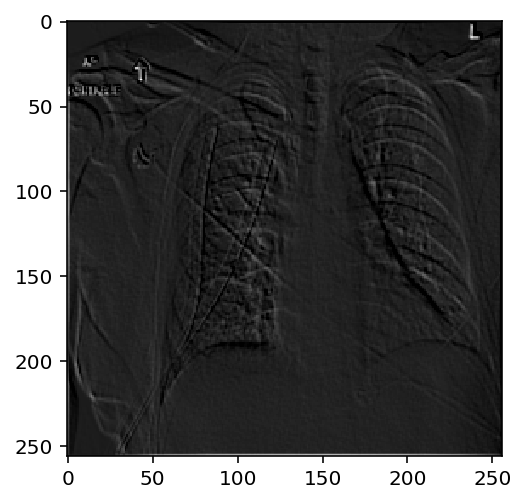

In [114]:
plt.imshow(activations[0][0,:,:,4], cmap='gray')

C:\Users\aamico\AppData\Local\Continuum\anaconda3\envs\deep_mouse\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in true_divide
  del sys.path[0]


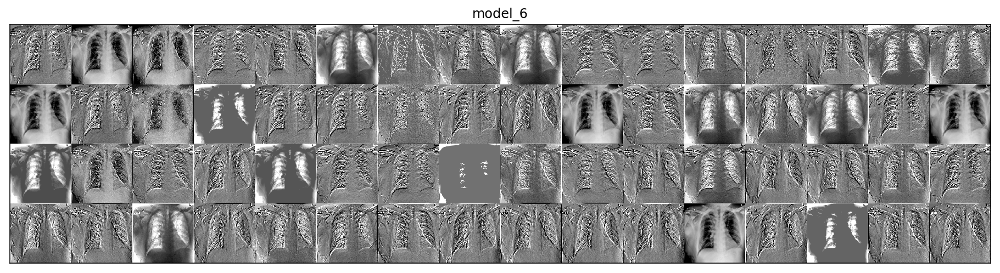

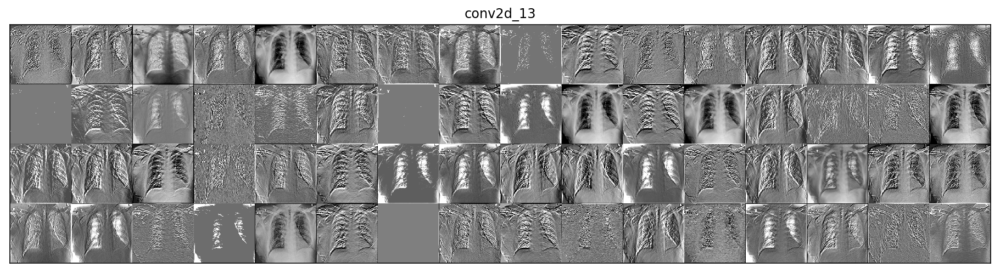

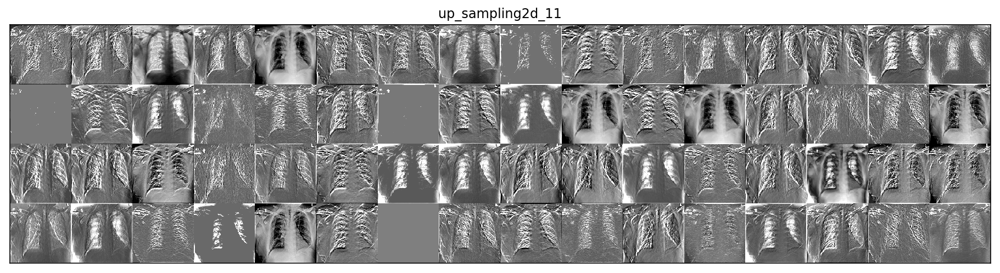

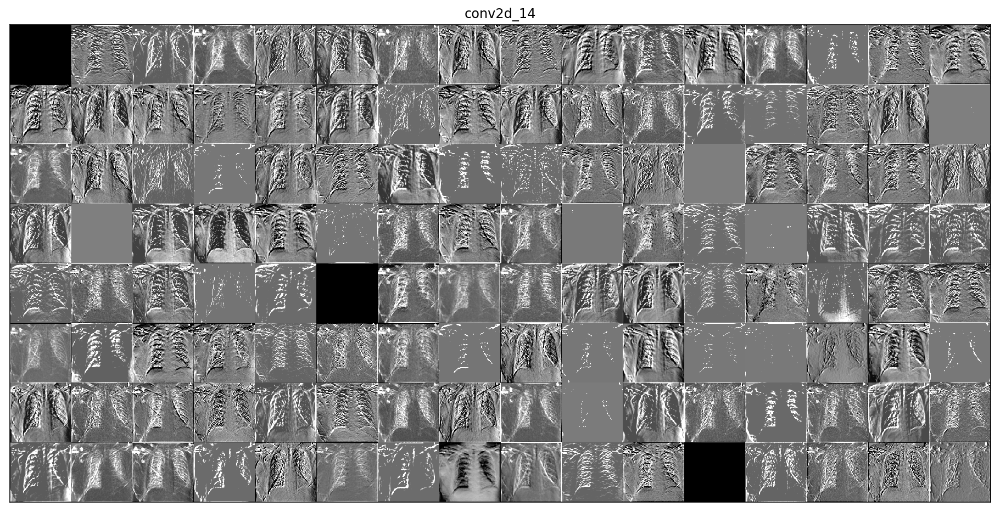

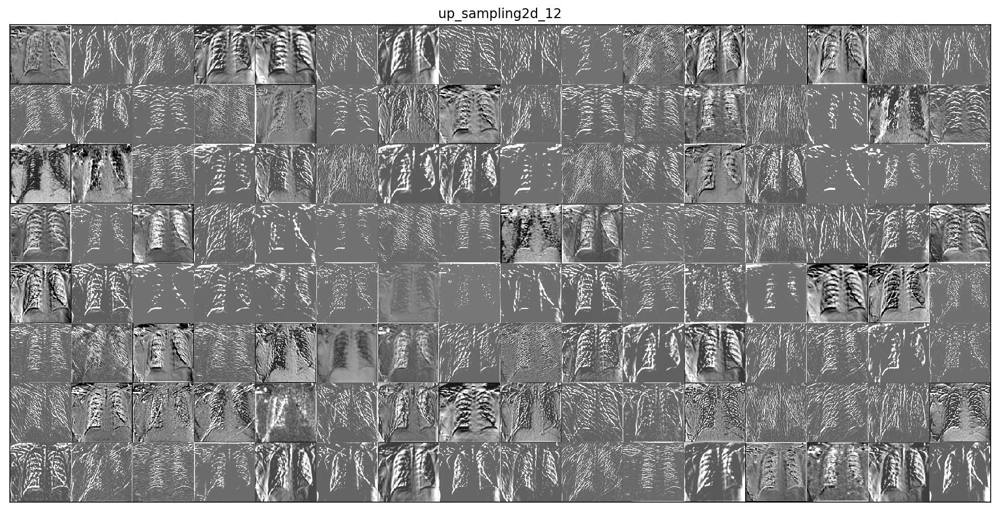

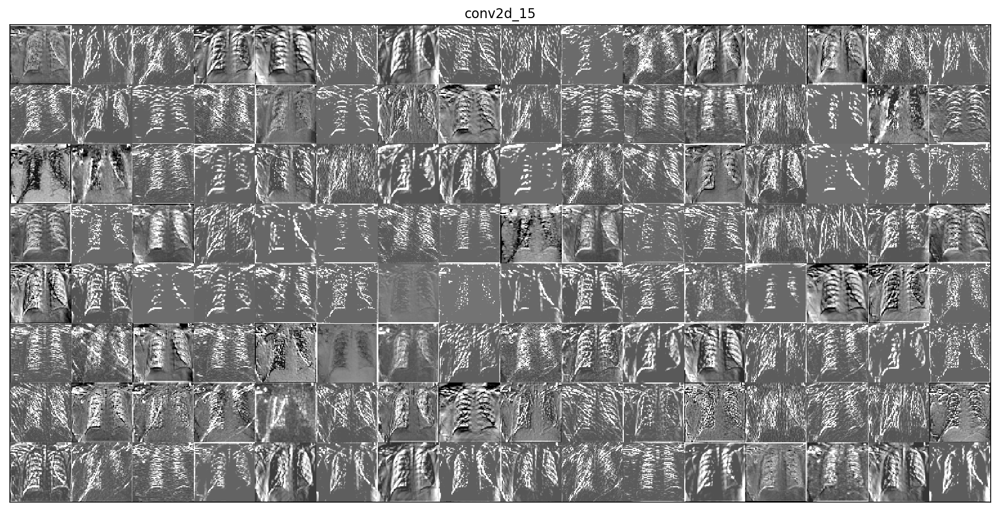

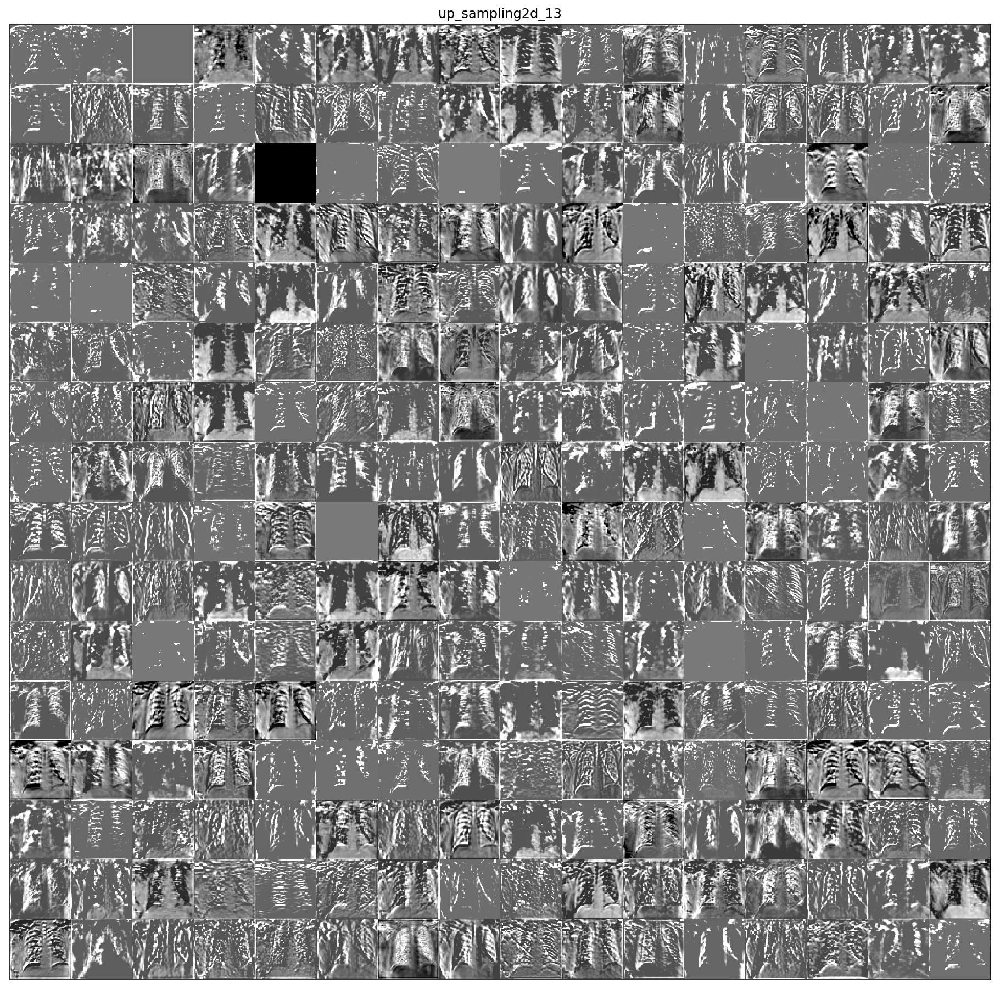

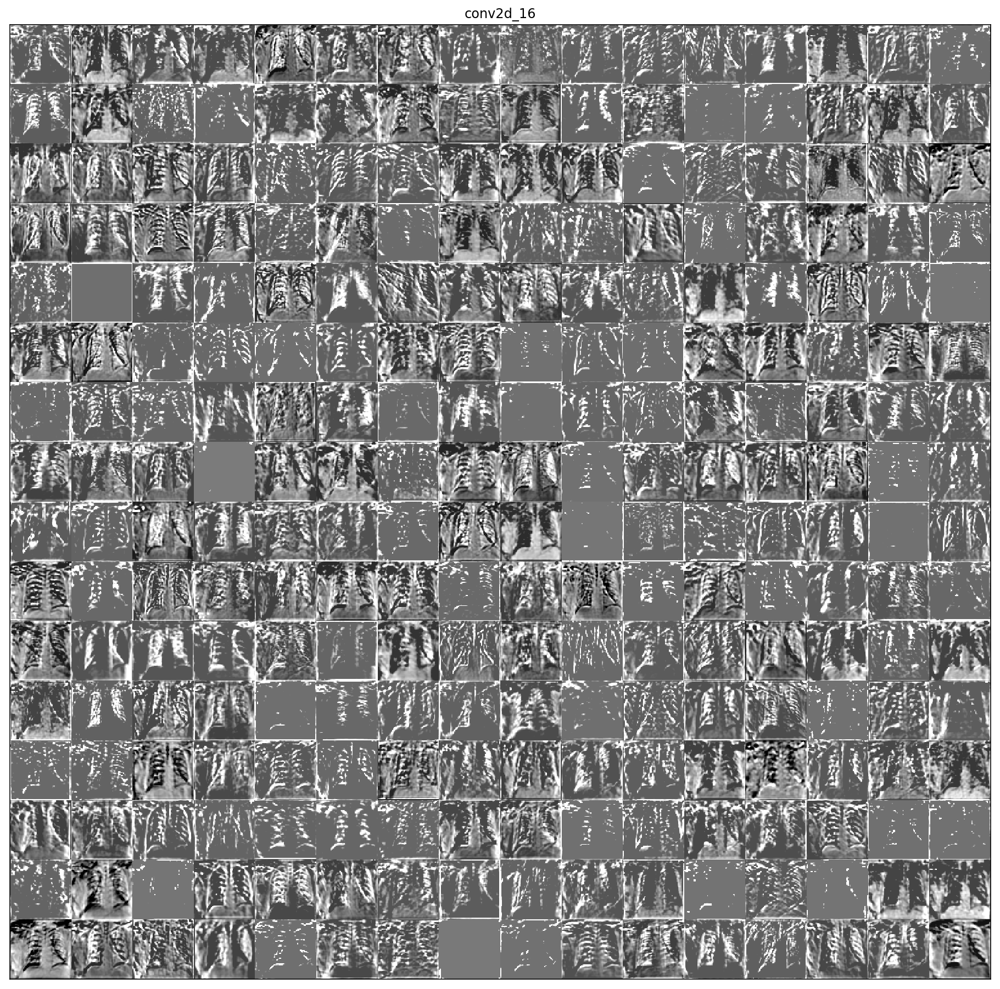

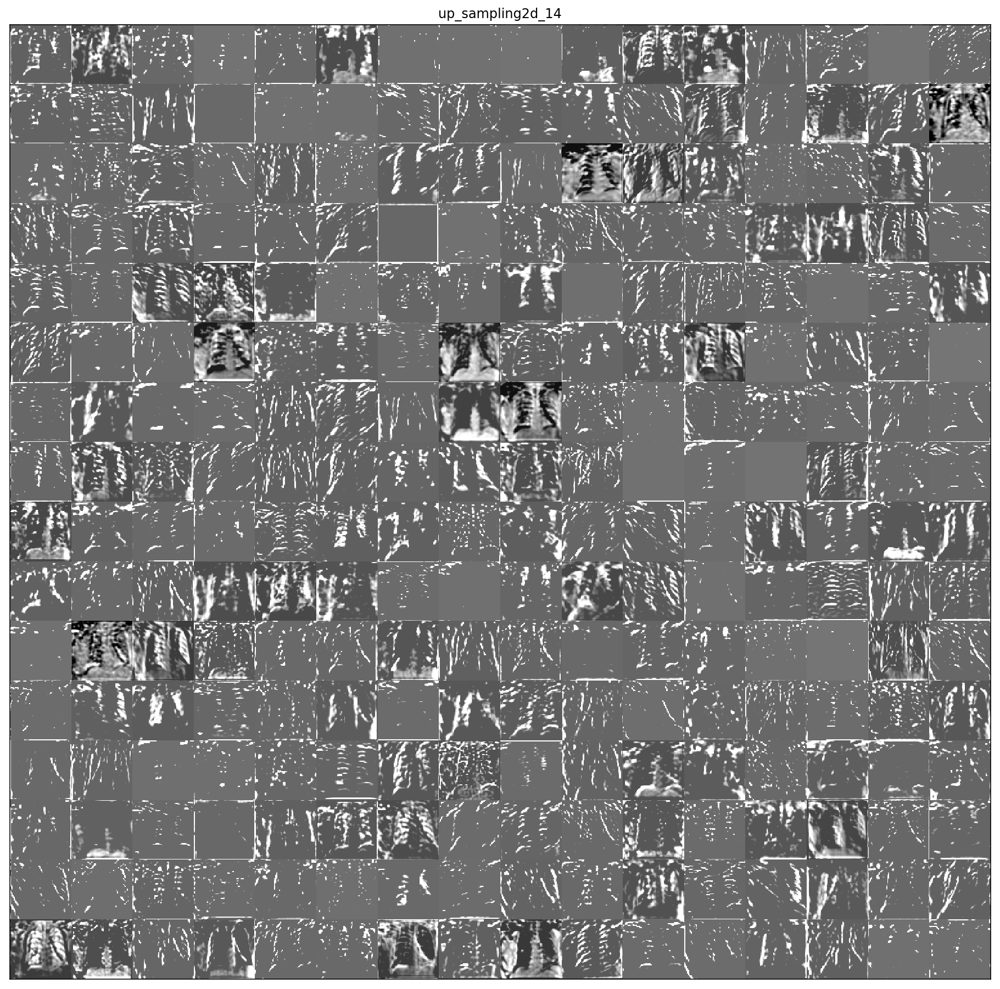

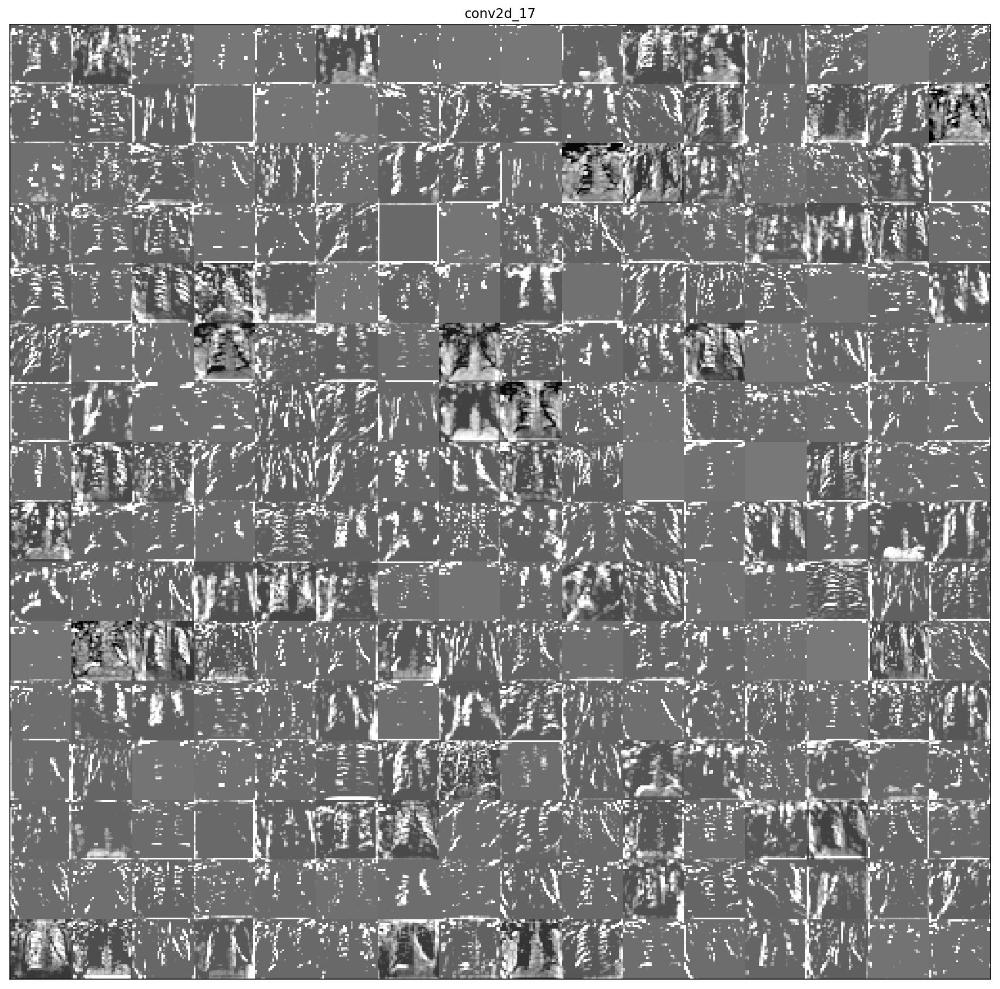

In [115]:
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = int(n_features//images_per_row)
    display_grid = np.zeros((size*n_cols, images_per_row*size))
    
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:,:,col*images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col*size:(col+1)*size, row*size:(row+1)*size] = channel_image
            
    scale = 1./size
    
    fig, ax = plt.subplots(1, figsize=(scale*display_grid.shape[1], scale*display_grid.shape[0]))
    ax.set_title(layer_name)
    ax.imshow(display_grid, aspect='auto', cmap='gray')
    ax.set_xticks([])
    ax.set_yticks([])

    

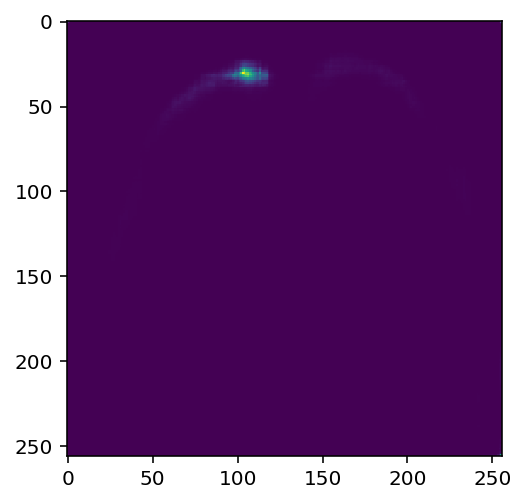

In [51]:
plt.imshow(activation.reshape(256,256))

In [133]:
hash('ciao')

-2694141683927557144

In [135]:
hash??


Signature: hash(obj, /)
Docstring:
Return the hash value for the given object.

Two objects that compare equal must also have the same hash value, but the
reverse is not necessarily true.
Type:      builtin_function_or_method


In [476]:
with h5py.File(data_filename, 'r') as f:
    test_generator = create_data_generator(f['X_test'][()], f['Y_test'][()], 32)

In [ ]:
# for a in range(2):
#     i, o = next(train_generator)
#     plt.imshow(i[0][:,:,2].reshape(256, 256), cmap='bone')
#     plt.imshow(o[0][:,:,0].reshape(256, 256), alpha=0.5)
#     plt.show()

In [13]:
from keras.applications import VGG16

conv_base = VGG16(weights = 'imagenet',
                  include_top = False,
                  input_shape = (256, 256, 3))

conv_base.trainable=False

In [ ]:
# conv_base.summary()

In [116]:
from keras import models


doctor_model = models.Sequential()
doctor_model.add(conv_base)

doctor_model.add(Conv2D(64, (3, 3), activation='relu', padding='same'))
doctor_model.add(UpSampling2D((2,2)))
doctor_model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
doctor_model.add(UpSampling2D((2,2)))
doctor_model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
doctor_model.add(UpSampling2D((2,2)))
doctor_model.add(Conv2D(16, (3, 3), activation='relu', padding='same'))
doctor_model.add(UpSampling2D((2,2)))
doctor_model.add(Conv2D(8, (3, 3), activation='relu', padding='same'))
doctor_model.add(UpSampling2D((2,2)))
doctor_model.add(Conv2D(1, (3, 3), activation='sigmoid', padding='same'))


In [ ]:
def customLoss(yTrue,yPred):
    return K.sum(K.log(yTrue) - K.log(yPred))

doctor_model.compile(loss='binary_crossentropy',
                    optimizer=optimizers.Adam(lr=1e-5))
outs = []

In [ ]:
out = doctor_model.fit_generator(train_generator,
                                 steps_per_epoch = 250,
                                 epochs=10,
                                 validation_data = dev_generator,
                                 validation_steps = 40)

outs.append(out)

Epoch 1/10
Creating generator from 1280 samples
Creating generator from 8000 samples
250/250 [==============================] - 147s 590ms/step - loss: 0.3140 - val_loss: 0.0652
Epoch 2/10
250/250 [==============================] - 142s 567ms/step - loss: 0.0513 - val_loss: 0.0436
Epoch 3/10
 10/250 [>.............................] - ETA: 1:46 - loss: 0.0405

In [ ]:
losses = []
val_losses = []

for out in outs:
    for h in out.history['loss']:
        losses.append(h)
    for h in out.history['val_loss']:
        val_losses.append(h)
        
plt.plot(losses)
plt.plot(val_losses)
plt.ylim(0,0.05)

In [141]:
t = []
sim = []

for i in range(40):
    a, b = next(test_generator)
    t.append(b)
    sim.append(doctor_model.predict(a))
    print(i, end=' ')
print(np.mean(sim), np.mean(t))

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 0.0034960438 0.0028945630204443612


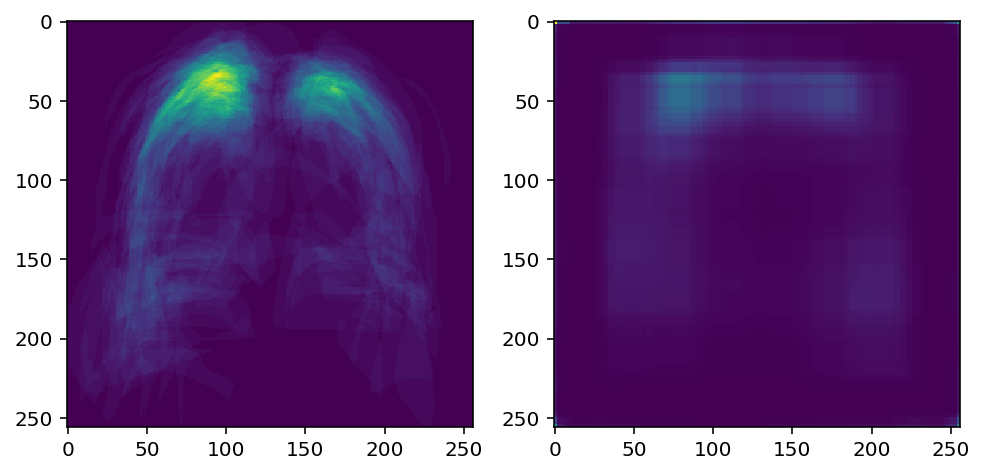

In [142]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4))
ax1.imshow(np.array(t).mean(0).mean(0).reshape(256, 256))
ax2.imshow(np.array(sim).mean(0).mean(0).reshape(256, 256))

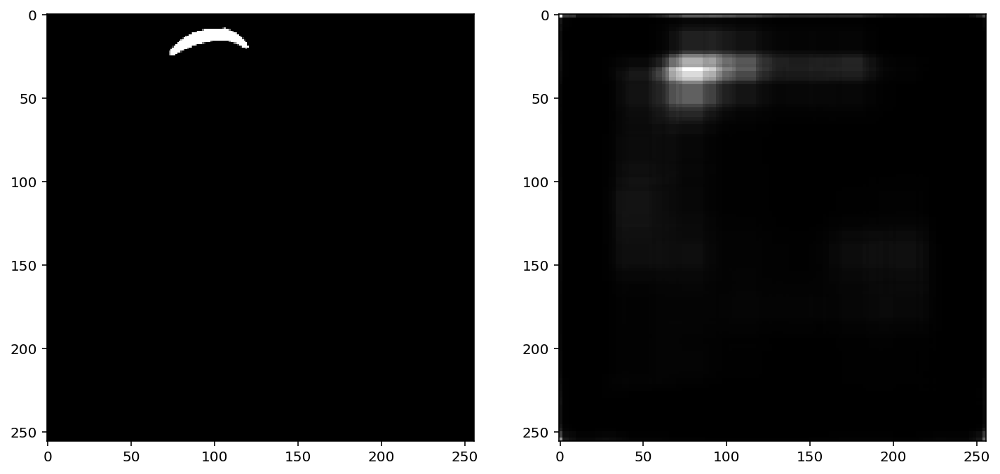

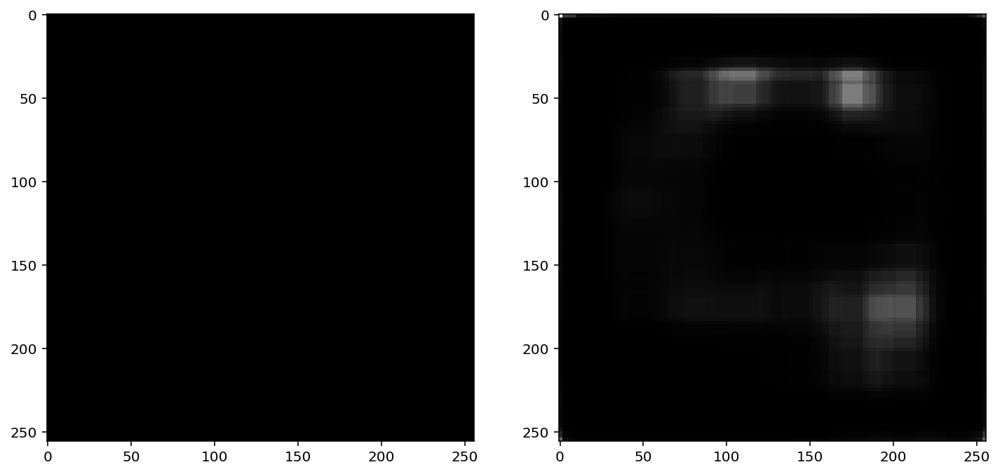

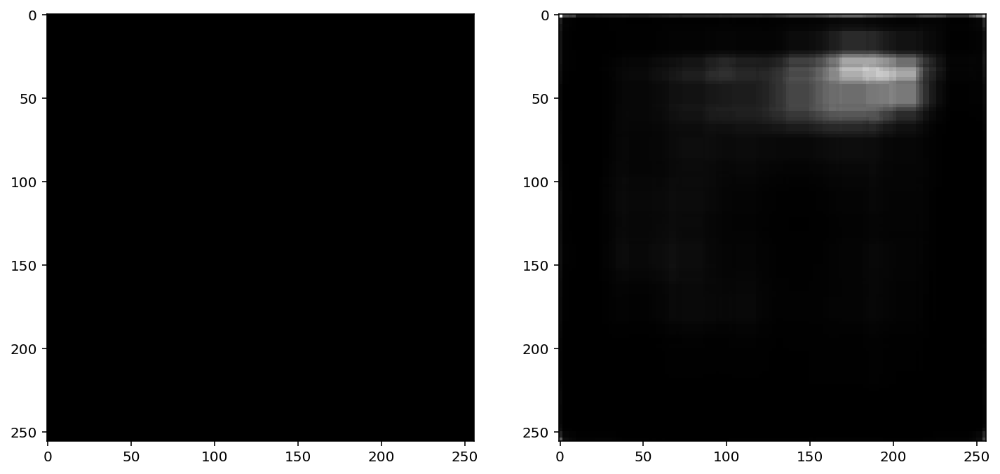

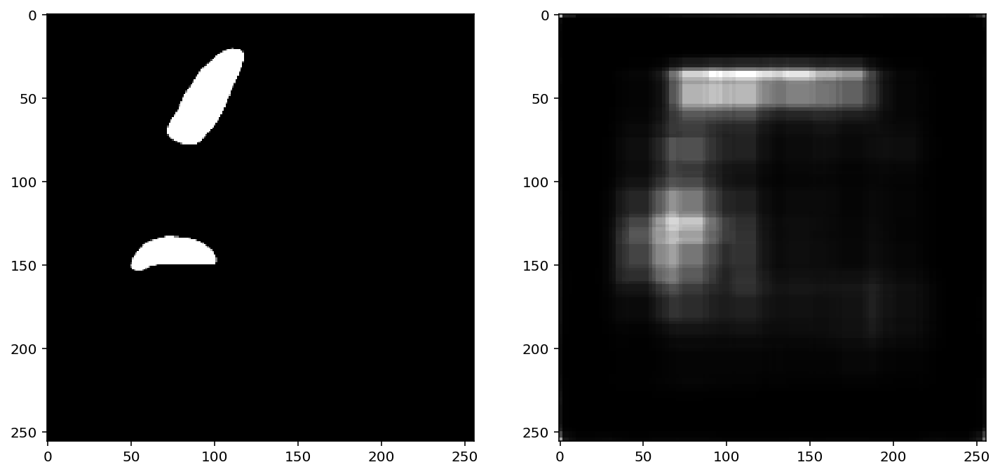

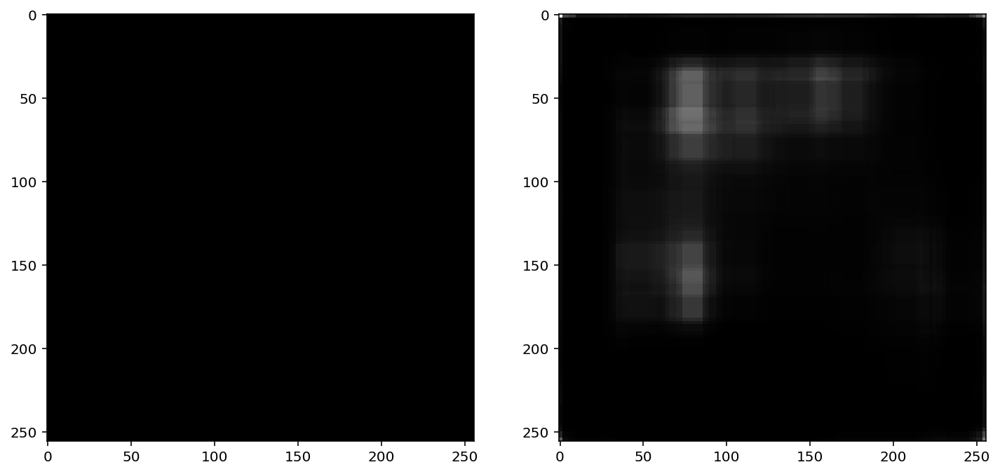

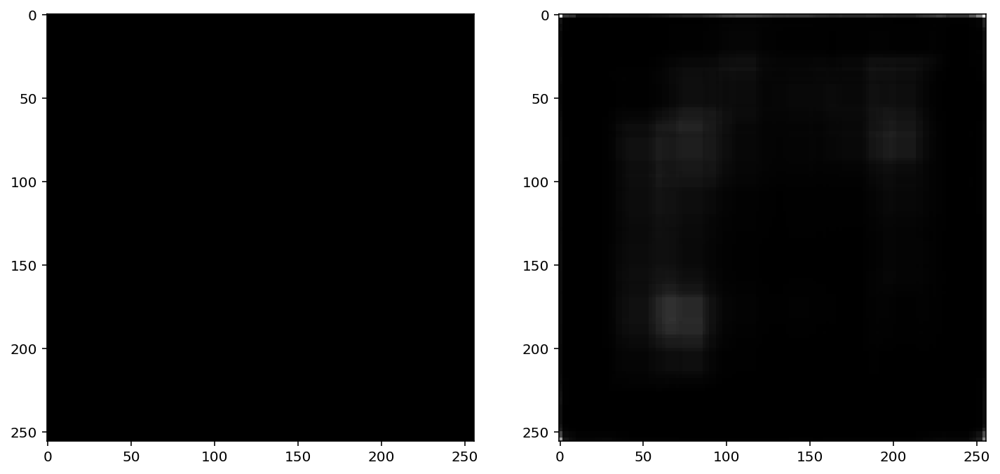

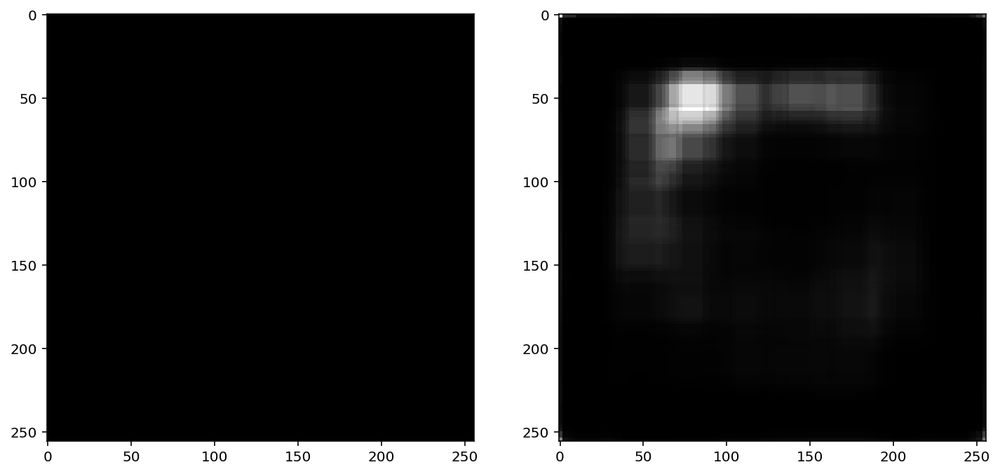

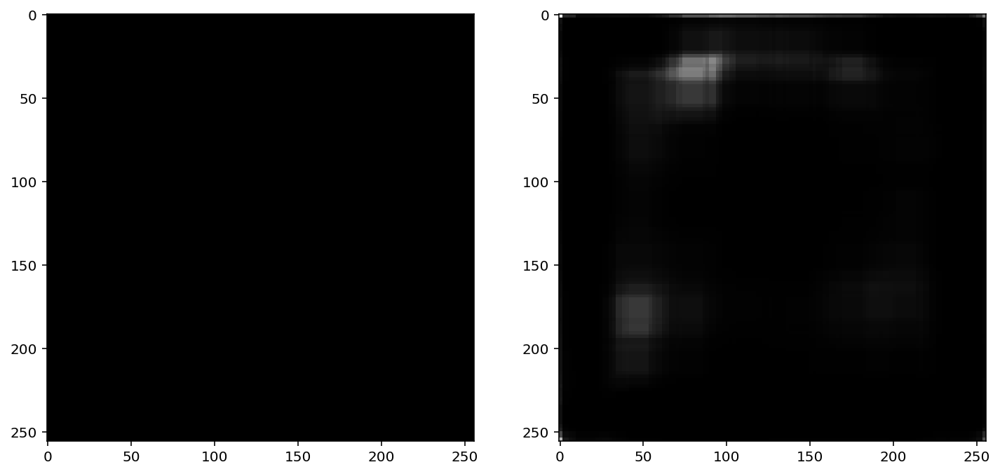

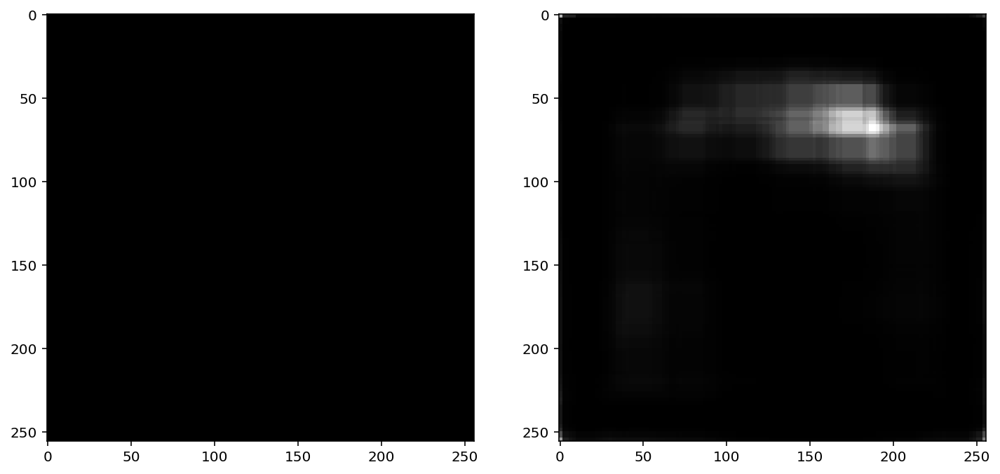

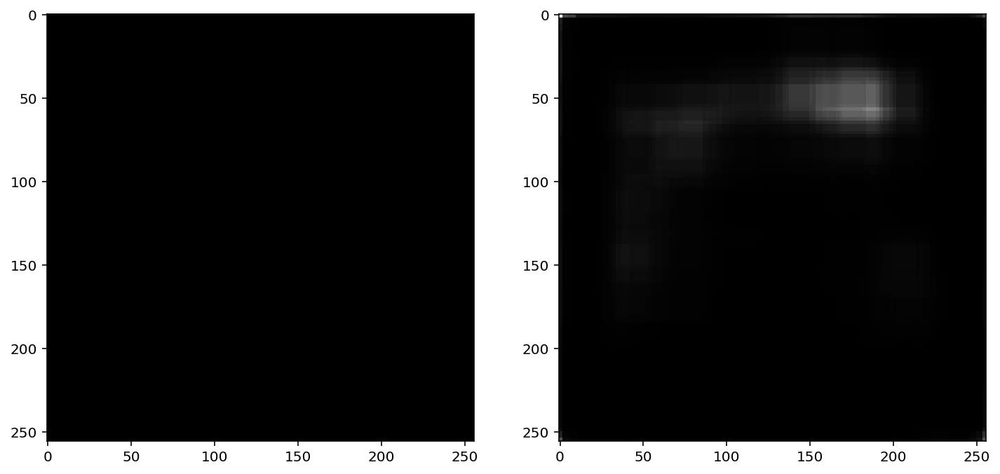

In [146]:
index = 0
for i in np.arange(10,20):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))
    ax1.imshow(t[index][i,...].reshape(256, 256), cmap='gray')
    ax2.imshow(sim[index][i,...].reshape(256, 256), cmap='gray')

In [ ]:
out = doctor_model.fit_generator(train_generator,
                                 steps_per_epoch = 250,
                                 epochs=1,
                                 validation_data = test_generator,
                                 validation_steps = 80)

outs.append(out)

(0, 0.05)

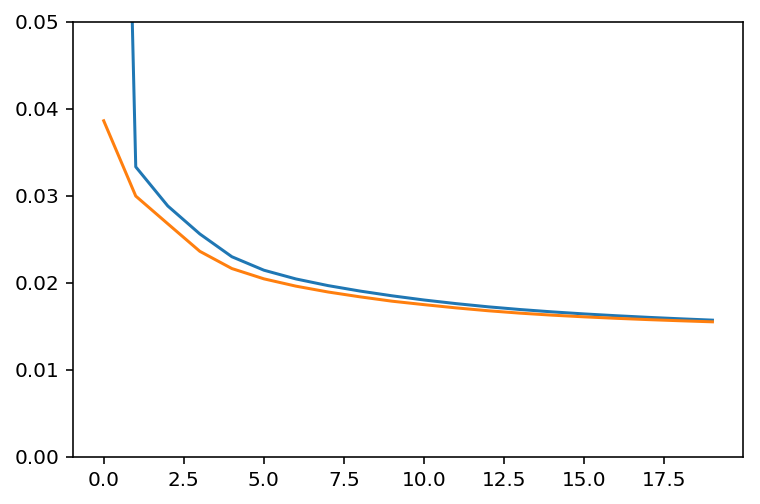

In [131]:


losses = []
val_losses = []

for out in outs:
    for h in out.history['loss']:
        losses.append(h)
    for h in out.history['val_loss']:
        val_losses.append(h)
        
plt.plot(losses)
plt.plot(val_losses)
plt.ylim(0,0.05)

In [ ]:
a, b = next(train_generator)


In [ ]:
img = a[0][:,:,:]
y = doctor_model.predict(a);
# img.shape

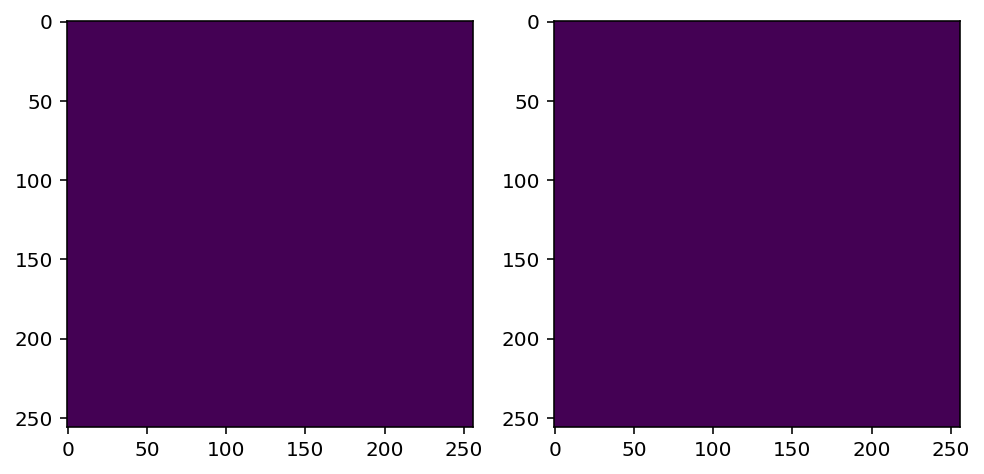

In [36]:
i=7

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4))
ax1.imshow(y[i, :, :, 0])
ax2.imshow(b[i, :, :, 0])



In [ ]:
%%time
conv_base.predict(a[0])
pass

ValueError: ignored

In [ ]:
xray_path = f'{root_path}data/train/*'
mask_path = f'{root_path}data/masks/*'
xray_files = sorted(glob.glob(xray_path))[-19::-1]
mask_files = sorted(glob.glob(mask_path))[-19::-1]
len(mask_files)

10657

In [ ]:
import tqdm
import time



def create_train_generator_test(train_files, target_files, batch_size):
    data_len = len(train_files)
    assert(len(target_files) == data_len), 'train-target data number mismatch'
    
    print(f'Creating generator from {data_len} samples')
    
    index = 0
    while True:
        data_train = np.zeros([batch_size, 256, 256, 1])
        data_target = np.zeros([batch_size, 256, 256, 1])

        for i in range(batch_size):
            t0 = time.time()
            img_train = img_to_array(load_img(train_files[index%data_len], color_mode='grayscale'))/255.
            data_train[i, ...] = img_train
          
            img_target = img_to_array(load_img(target_files[index%data_len], color_mode='grayscale'))/255.
            data_target[i, ...] = img_target
            
            if (time.time()-t0)>0.01:
                print(f'{index} - {time.time()-t0} - {train_files[index%data_len]}')
            
            index = index +1
            
        data_train = data_train * np.ones([batch_size, 256, 256, 3])
        data_target = data_target
        yield data_train, data_target
        
        

random.seed(16)
xray_path = f'{root_path}data/train/*'
mask_path = f'{root_path}data/masks/*'
xray_files = sorted(glob.glob(xray_path))[-19::-1]
mask_files = sorted(glob.glob(mask_path))[-19::-1]

c = list(zip(xray_files, mask_files))
random.shuffle(c)
xray_files, mask_files = zip(*c)


X_train_files = xray_files[:32*250]
y_train_files = mask_files[:32*250]

X_test_files = xray_files[32*250:32*(80+250)]
y_test_files = mask_files[32*250:32*(80+250)]
        
train_generator = create_train_generator_test(train_files=X_train_files, target_files=y_train_files, batch_size=32)


In [ ]:
# %%time


# for i in tqdm.tqdm(range(333)):
#     a, b = next(train_generator)
#     pass

In [ ]:
%%time 
a, b = next(train_generator)

StopIteration: ignored